<a href="https://colab.research.google.com/github/ChenulaJ/CAM-shots/blob/main/AIDsys.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Setting Up Enviroment**

In [13]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [15]:
!unzip gdrive/My\Drive/AID/animal.zip

Archive:  gdrive/MyDrive/AID/animal.zip
replace animal_dataset/images/train/1.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace animal_dataset/images/train/10.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [3]:
!pip install utils

  Preparing metadata (setup.py) ... done
  Created wheel for utils: filename=utils-1.0.2-py2.py3-none-any.whl size=13906 sha256=b8a0b2c7f2a01e664180213dfcfb33312ac4f29daa2ddea526405f7d14967666
  Stored in directory: /root/.cache/pip/wheels/b8/39/f5/9d0ca31dba85773ececf0a7f5469f18810e1c8a8ed9da28ca7
Successfully built utils


In [8]:
!git clone https://github.com/ultralytics/yolov5  # clone
%cd yolov5
%pip install -qr requirements.txt  # install
import torch
import utils
display = utils.notebook_init()  # checks

YOLOv5 🚀 v7.0-393-g6981c274 Python-3.10.12 torch-2.5.1+cu121 CPU


Setup complete ✅ (2 CPUs, 12.7 GB RAM, 33.5/107.7 GB disk)


# **Data Preparation**

Dataloader Creation:

The create_dataloader function is used to create data loaders for both training and validation datasets. This function handles reading image files, loading annotations, and applying transformations

In [ ]:
from utils.dataloaders import create_dataloader

train_loader, dataset = create_dataloader(
    train_path,
    imgsz,
    batch_size // WORLD_SIZE,
    gs,
    single_cls,
    hyp=hyp,
    augment=True,
    cache=None if opt.cache == "val" else opt.cache,
    rect=opt.rect,
    rank=LOCAL_RANK,
    workers=workers,
    image_weights=opt.image_weights,
    quad=opt.quad,
    prefix=colorstr("train: "),
    shuffle=True,
    seed=opt.seed,
)


 **Label Format Conversion**:


In [ ]:
# Convert annotations to YOLO format
def convert_to_yolo_format(image_width, image_height, bbox):
    x_center = (bbox[0] + bbox[2]) / 2 / image_width
    y_center = (bbox[1] + bbox[3]) / 2 / image_height
    width = (bbox[2] - bbox[0]) / image_width
    height = (bbox[3] - bbox[1]) / image_height
    return x_center, y_center, width, height

# Example bbox [x_min, y_min, x_max, y_max]
bbox = [50, 30, 200, 150]
image_width, image_height = 640, 480
print(convert_to_yolo_format(image_width, image_height, bbox))


**Dataset Splitting**:

The data is split into train and validation which is of the ratio 80:20

In [ ]:
from sklearn.model_selection import train_test_split
import glob

# Get all image paths
images = glob.glob('/content/animal_dataset/images/*.jpg')

# Split into train, val, and test sets
train_images, val_images = train_test_split(images, test_size=0.2, random_state=42)

print(f"Training images: {len(train_images)}")
print(f"Validation images: {len(val_images)}")


**Image Preprocessing:**

Images are normalized and resized during loading.


In [ ]:
imgs = imgs.to(device, non_blocking=True).float() / 255  # uint8 to float32, 0-255 to 0.0-1.0


**Label Loading and Preparation:**

In [ ]:
labels = np.concatenate(dataset.labels, 0)


# **Data Augmentation:**

Mosaic Augmentation



In [ ]:
if self.mosaic and random.random() < self.hyp['mosaic']:
    mosaic_labels, mosaic_image = load_mosaic(self, index)


Horizontal Flip

In [ ]:
if random.random() < self.hyp['flip']:
    image = np.fliplr(image)
    labels[:, 1] = 1 - labels[:, 1]  # Adjust x-center


Color Augmentation

In [ ]:
if self.hyp['hsv_h'] or self.hyp['hsv_s'] or self.hyp['hsv_v']:
    augment_hsv(image, hgain=self.hyp['hsv_h'], sgain=self.hyp['hsv_s'], vgain=self.hyp['hsv_v'])


Scaling, Translation, and Rotation

In [ ]:
if random.random() < self.hyp['scale']:
    image, labels = random_affine(
        image, labels,
        degrees=self.hyp['degrees'],
        translate=self.hyp['translate'],
        scale=self.hyp['scale'],
        shear=self.hyp['shear']
    )


# **Data Training**

In [5]:
!python train.py --img 415 --batch 31 --epochs 50 --data coco128.yaml --weights /content/gdrive/MyDrive/yolov5_best.pt --cache


2025-01-07 22:50:59.147519: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-01-07 22:50:59.172058: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-01-07 22:50:59.179877: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=/content/gdrive/MyDrive/yolov5_best.pt, cfg=, data=coco128.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=31, imgsz=415, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=data/hyps, resume_evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=

# **Data Prediction / Detection**

Only detections with a confidence score of 0.25 or higher will be displayed in the results.

In [ ]:
@smart_inference_mode()
def run(
    weights=ROOT / "yolov5s.pt",  # model path or triton URL
    source=ROOT / "data/images",  # file/dir/URL/glob/screen/0(webcam)
    data=ROOT / "data/coco128.yaml",  # dataset.yaml path
    imgsz=(640, 640),  # inference size (height, width)
    conf_thres=0.25,  # confidence threshold
    iou_thres=0.45,  # NMS IOU threshold
    max_det=1000,  # maximum detections per image
    device="",  # cuda device, i.e. 0 or 0,1,2,3 or cpu
    view_img=False,  # show results
    save_txt=False,  # save results to *.txt
    save_format=0,  # save boxes coordinates in YOLO format or Pascal-VOC format (0 for YOLO and 1 for Pascal-VOC)
    save_csv=False,  # save results in CSV format
    save_conf=False,  # save confidences in --save-txt labels
    save_crop=False,  # save cropped prediction boxes
    nosave=False,  # do not save images/videos
    classes=None,  # filter by class: --class 0, or --class 0 2 3
    agnostic_nms=False,  # class-agnostic NMS
    augment=False,  # augmented inference
    visualize=False,  # visualize features
    update=False,  # update all models
    project=ROOT / "runs/detect",  # save results to project/name
    name="exp",  # save results to project/name
    exist_ok=False,  # existing project/name ok, do not increment
    line_thickness=3,  # bounding box thickness (pixels)
    hide_labels=False,  # hide labels
    hide_conf=False,  # hide confidences
    half=False,  # use FP16 half-precision inference
    dnn=False,  # use OpenCV DNN for ONNX inference
    vid_stride=1,  # video frame-rate stride
):

Detect from Images:

In [6]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 196 --conf 0.25 --source ../testpic.jpg

detect: weights=['runs/train/exp/weights/best.pt'], source=../testpic.jpg, data=data/coco128.yaml, imgsz=[196, 196], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-392-gf003c3df Python-3.10.12 torch-2.5.1+cu121 CPU

Fusing layers... 
Model summary: 157 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
WARNING ⚠️ --img-size [196, 196] must be multiple of max stride 32, updating to [224, 224]
image 1/1 /content/testpic.jpg: 224x160 1 elephant, 63.9ms
Speed: 0.5ms pre-process, 63.9ms inference, 1.8ms NMS per image at shape (1, 3, 224, 224)
Results saved to runs/detect/exp


Detect from Videos:

In [22]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 224 --conf 0.25 --source /content/video.mp4 --project /content/yolov5/runs/detect --name exp

python3: can't open file '/content/detect.py': [Errno 2] No such file or directory


In [7]:
!ffmpeg -i /content/yolov5/runs/detect/exp/video.mp4 -c:v libx264 -preset slow -crf 22 -c:a copy /content/yolov5/runs/detect/exp/video_converted.mp4


ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

# **Output and Visualisation**

**Video Detection**:

In [9]:
from IPython.display import HTML

def display_video(video_path):
    from base64 import b64encode
    with open(video_path, 'rb') as f:
        video = f.read()
    data_url = "data:video/mp4;base64," + b64encode(video).decode()
    return HTML(f'''
        <video width="640" height="480" controls>
            <source src="{data_url}" type="video/mp4">
        </video>
    ''')

# Path to the processed or converted video
video_path = '/content/yolov5/runs/detect/exp/video_converted.mp4'
display_video(video_path)


**Image Detection**:

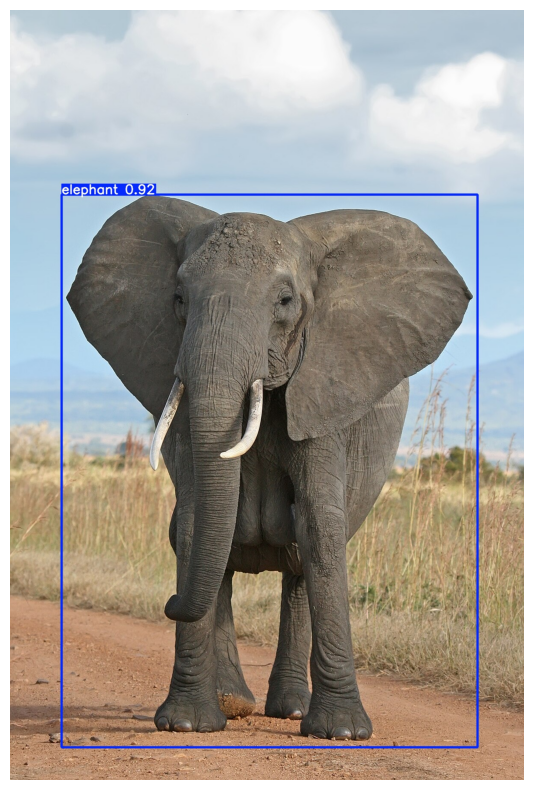

In [7]:
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

image = cv2.imread("runs/detect/exp/testpic.jpg")
height, width = image.shape[:2]
resized_image = cv2.resize(image,(3*width, 3*height), interpolation = cv2.INTER_CUBIC)

fig = plt.gcf()
fig.set_size_inches(18, 10)
plt.axis("off")
plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
plt.show()

In [21]:
# Evaluate model performance on the validation set
!python val.py --weights runs/train/exp/weights/best.pt --data coco128.yaml --task val --save-json


val: data=/content/yolov5/yolov5/data/coco128.yaml, weights=['runs/train/exp/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=True, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-393-g6981c274 Python-3.10.12 torch-2.5.1+cu121 CPU

Traceback (most recent call last):
  File "/content/yolov5/yolov5/val.py", line 604, in <module>
    main(opt)
  File "/content/yolov5/yolov5/val.py", line 575, in main
    run(**vars(opt))
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/_contextlib.py", line 116, in decorate_context
    return func(*args, **kwargs)
  File "/content/yolov5/yolov5/val.py", line 270, in run
    model = DetectMultiBackend(weights, device=device, dnn=dnn, data=data, fp16=half)
  File "/content/yolov5/yolov5/models/common.py", line 489, in __init__
    model